In [2]:
# Data manipulation and numerical operations
import numpy as np
import pandas as pd

# Data visualization
import matplotlib.pyplot as plt
import seaborn as sns

# Machine learning and statistical models
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, RandomForestRegressor
from sklearn.model_selection import RandomizedSearchCV
from sklearn.cluster import KMeans
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, mean_absolute_percentage_error

# Deep learning
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Conv2D, MaxPooling2D, Flatten
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import EarlyStopping
import pandas as pd
import numpy as np

In [3]:
# Plotly libraries
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.colors import n_colors
from plotly.subplots import make_subplots

# Machine learning library
from pycaret.regression import *

In [4]:
# data 
audi = pd.read_csv(r'C:\Users\sameer\Desktop\UCB_MIDS\w207\w207-final-project\Data\audi.csv')
bmw = pd.read_csv(r"C:\Users\sameer\Desktop\UCB_MIDS\w207\w207-final-project\Data\bmw.csv")
cclass = pd.read_csv(r"C:\Users\sameer\Desktop\UCB_MIDS\w207\w207-final-project\Data\cclass.csv")
focus = pd.read_csv(r"C:\Users\sameer\Desktop\UCB_MIDS\w207\w207-final-project\Data\focus.csv")
ford = pd.read_csv(r"C:\Users\sameer\Desktop\UCB_MIDS\w207\w207-final-project\Data\ford.csv")
hyundai = pd.read_csv(r"C:\Users\sameer\Desktop\UCB_MIDS\w207\w207-final-project\Data\hyundi.csv")
merc = pd.read_csv(r"C:\Users\sameer\Desktop\UCB_MIDS\w207\w207-final-project\Data\merc.csv")
skoda = pd.read_csv(r"C:\Users\sameer\Desktop\UCB_MIDS\w207\w207-final-project\Data\skoda.csv")
toyota = pd.read_csv(r"C:\Users\sameer\Desktop\UCB_MIDS\w207\w207-final-project\Data\toyota.csv")
vauxhall = pd.read_csv(r"C:\Users\sameer\Desktop\UCB_MIDS\w207\w207-final-project\Data\vauxhall.csv")
vw = pd.read_csv(r"C:\Users\sameer\Desktop\UCB_MIDS\w207\w207-final-project\Data\vw.csv")

In [5]:
audi.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10668 entries, 0 to 10667
Data columns (total 9 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   model         10668 non-null  object 
 1   year          10668 non-null  int64  
 2   price         10668 non-null  int64  
 3   transmission  10668 non-null  object 
 4   mileage       10668 non-null  int64  
 5   fuelType      10668 non-null  object 
 6   tax           10668 non-null  int64  
 7   mpg           10668 non-null  float64
 8   engineSize    10668 non-null  float64
dtypes: float64(2), int64(4), object(3)
memory usage: 750.2+ KB


In [6]:
audi.shape

(10668, 9)

In [7]:
audi.head()

,model,year,price,transmission,mileage,fuelType,tax,mpg,engineSize
0,A1,2017,12500,Manual,15735,Petrol,150,55.4,1.4
1,A6,2016,16500,Automatic,36203,Diesel,20,64.2,2.0
2,A1,2016,11000,Manual,29946,Petrol,30,55.4,1.4
3,A4,2017,16800,Automatic,25952,Diesel,145,67.3,2.0
4,A3,2019,17300,Manual,1998,Petrol,145,49.6,1.0


#### Data Aggregation

Different files are merged together, additional 'manufacturer column' is added to create a key feature. 'Has_tax' column is also created to indicate if the column was missing in the initial file. 

In [8]:
audi['manufacturer'] = 'Audi'
audi['has_tax'] = 1

bmw['manufacturer'] = 'BMW'
bmw['has_tax'] = 1

cclass['manufacturer'] = 'Mercedes-Benz'
cclass['has_tax'] = 0
cclass['tax'] = np.nan

focus['manufacturer'] = 'Ford'
focus['has_tax'] = 0
focus['tax'] = np.nan

hyundai['manufacturer'] = 'Hyundai Motor'
hyundai['has_tax'] = 1
hyundai = hyundai.rename(columns={"tax(£)": "tax"})

merc['manufacturer'] = 'Mercedes'
merc['has_tax'] = 1

skoda['manufacturer'] = 'Skoda'
skoda['has_tax'] = 1

toyota['manufacturer'] = 'Toyota'
toyota['has_tax'] = 1

vauxhall['manufacturer'] = 'Vauxhall'
vauxhall['has_tax'] = 1

vw['manufacturer'] = 'Volkswagen'
vw['has_tax'] = 1

In [9]:
# aggregation
cars = pd.concat([audi, bmw, cclass, focus, hyundai, merc, skoda, toyota, vauxhall, vw], ignore_index=True)

# dimensionality
cars.shape

(90575, 11)

In [10]:
cars

,model,year,price,transmission,mileage,fuelType,tax,mpg,engineSize,manufacturer,has_tax
0,A1,2017,12500,Manual,15735,Petrol,150.0,55.4,1.4,Audi,1
1,A6,2016,16500,Automatic,36203,Diesel,20.0,64.2,2.0,Audi,1
2,A1,2016,11000,Manual,29946,Petrol,30.0,55.4,1.4,Audi,1
3,A4,2017,16800,Automatic,25952,Diesel,145.0,67.3,2.0,Audi,1
4,A3,2019,17300,Manual,1998,Petrol,145.0,49.6,1.0,Audi,1
...,...,...,...,...,...,...,...,...,...,...,...
90570,Eos,2012,5990,Manual,74000,Diesel,125.0,58.9,2.0,Volkswagen,1
90571,Fox,2008,1799,Manual,88102,Petrol,145.0,46.3,1.2,Volkswagen,1
90572,Fox,2009,1590,Manual,70000,Petrol,200.0,42.0,1.4,Volkswagen,1
90573,Fox,2006,1250,Manual,82704,Petrol,150.0,46.3,1.2,Volkswagen,1


In [11]:
print(cars.isnull().sum())

model              0
year               0
price              0
transmission       0
mileage            0
fuelType           0
tax             9353
mpg             9353
engineSize         0
manufacturer       0
has_tax            0
dtype: int64


In [12]:
# Impute missing values with the median
cars['tax'].fillna(cars['tax'].median(), inplace=True)
cars['mpg'].fillna(cars['mpg'].median(), inplace=True)

In [13]:
print(cars.isnull().sum())

model           0
year            0
price           0
transmission    0
mileage         0
fuelType        0
tax             0
mpg             0
engineSize      0
manufacturer    0
has_tax         0
dtype: int64


### EDA

In [14]:
# Count cars per manufacturer
fig = px.histogram(cars, x="manufacturer", hover_data=cars.columns)
fig.update_layout(title='Quantitative representation of the number of vehicles per manufacturer')
fig.show()

In [15]:
cars.describe()

,year,price,mileage,tax,mpg,engineSize,has_tax
count,90575.000000,90575.000000,90575.000000,90575.000000,90575.000000,90575.000000,90575.000000
mean,2017.143936,17804.562407,22958.947325,124.231962,54.430557,1.723292,0.896738
std,2.142557,10225.135788,21497.882586,60.353059,16.223700,0.558411,0.304303
min,1970.000000,450.000000,1.000000,0.000000,0.300000,0.000000,0.000000
25%,2016.000000,10700.000000,6910.500000,125.000000,47.100000,1.400000,1.000000
50%,2017.000000,15599.000000,17000.000000,145.000000,53.300000,1.600000,1.000000
75%,2019.000000,22339.000000,32507.500000,145.000000,60.100000,2.000000,1.000000
max,2020.000000,159999.000000,323000.000000,580.000000,470.800000,6.600000,1.000000


Summary statistics look mostly normal, but the mileage/mpg minimum and maximums may be outliers. 

In [16]:
# Price
fig = px.histogram(cars, x="price", marginal="box")
fig.update_layout(title='Statistical Distribution of Price')
fig.show()

In [17]:
# Year
fig = px.histogram(cars, x="year", marginal="box")
fig.update_layout(title='Statistical Distribution of Year')
fig.show()

Note the 1970 data point

In [18]:
# MPG
fig = px.histogram(cars, x="mpg", marginal="box")
fig.update_layout(title='Statistical Distribution of Miles Per Gallon')
fig.show()

Note the 470 mpg data point

In [19]:
# Total mileage
fig = px.histogram(cars, x="mileage", marginal="box")
fig.update_layout(title='Statistical Distribution of Mileage')
fig.show()

Many cars with 0 or 1 mile? 

In [20]:
# Engine size
fig = px.histogram(cars, x="engineSize", marginal="box")
fig.update_layout(title='Statistical Distribution of Engine Size')
fig.show()

#### Let's look at each feature in relation to price

In [21]:
# Manufacturer vs Price
fig = px.scatter(cars, x='manufacturer', y='price', color='price')
fig.update_layout(title='Sales Price VS Manufacturer',xaxis_title="Manufacturer",yaxis_title="Price")
fig.show()

As expected, German cars generally trend in the higher prices

In [22]:
# Mileage vs Price
fig = px.scatter(cars, x='mileage', y='price', color='price')
fig.update_layout(title='Sales Price VS Mileage',xaxis_title="Mileage",yaxis_title="Price")
fig.show()

Lower miles = retain value

In [23]:
# Transmission vs Price
fig = px.scatter(cars, x='transmission', y='price', color='price')
fig.update_layout(title='Sales Price VS Transmission System',xaxis_title="Transmission",yaxis_title="Price")
fig.show()

#### Baseline modeling

In [24]:
cars.columns

Index(['model', 'year', 'price', 'transmission', 'mileage', 'fuelType', 'tax',
       'mpg', 'engineSize', 'manufacturer', 'has_tax'],
      dtype='object')

In [25]:
# Define the features (X) and the target (y)
X = cars.drop(columns=['price'], axis=1)
y = cars['price']

# Convert categorical variables to dummy variables
X = pd.get_dummies(X, drop_first=True)

# Split the data into training, validation, and test sets
X_train_full, X_test, y_train_full, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_train_full, y_train_full, test_size=0.25, random_state=42) # 0.25 x 0.8 = 0.2

In [26]:
rf = RandomForestRegressor(random_state=42)

# Define the parameter grid
param_grid = {
    'n_estimators': [100, 200, 300, 400, 500],
    'max_features': ['auto', 'sqrt', 'log2'],
    'max_depth': [10, 20, 30, 40, 50, None],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

# RandomizedSearchCV setup
rf_random = RandomizedSearchCV(estimator=rf, param_distributions=param_grid, n_iter=100, cv=3, verbose=2, random_state=42, n_jobs=-1)

# Fit the random search model
rf_random.fit(X_train, y_train)

# Step 3: Evaluate on the validation set
best_rf = rf_random.best_estimator_

# Make predictions on the validation set
y_val_pred = best_rf.predict(X_val)

# Evaluate the model on the validation set
val_mape = mean_absolute_percentage_error(y_val, y_val_pred)
print(f'Validation Mean Absolute Percentage Error (MAPE): {val_mape:.2%}')

# Step 4: Train the final model on the combined training and validation sets
best_rf.fit(X_train_full, y_train_full)

# Make predictions on the test set
y_test_pred = best_rf.predict(X_test)

# Evaluate the model on the test set
test_mape = mean_absolute_percentage_error(y_test, y_test_pred)
print(f'Test Mean Absolute Percentage Error (MAPE): {test_mape:.2%}')

# Display the best parameters
print(f'Best Parameters: {rf_random.best_params_}')

Fitting 3 folds for each of 100 candidates, totalling 300 fits
Validation Mean Absolute Percentage Error (MAPE): 7.47%
Test Mean Absolute Percentage Error (MAPE): 7.49%
Best Parameters: {'n_estimators': 200, 'min_samples_split': 10, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'max_depth': 50, 'bootstrap': False}


In [28]:
y_train_pred = best_rf.predict(X_train)
train_mape = mean_absolute_percentage_error(y_train, y_train_pred)
print(f'Training Mean Absolute Percentage Error (MAPE): {train_mape:.2%}')

Training Mean Absolute Percentage Error (MAPE): 4.47%


The model seems to be performing quite well, let's take a look at feature importance and residuals.

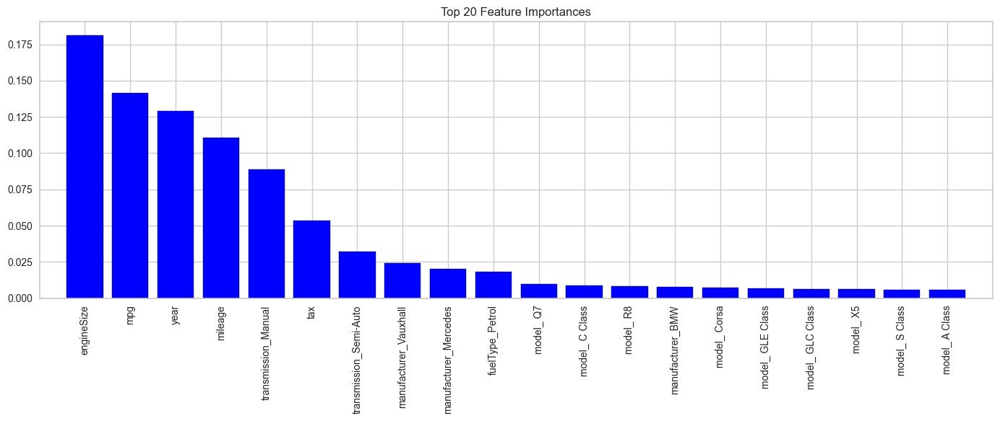

In [31]:
# Get feature importances
importances = best_rf.feature_importances_
indices = np.argsort(importances)[::-1]
features = X.columns

# Select top 20 features
top_n = 20
top_indices = indices[:top_n]
top_features = features[top_indices]
top_importances = importances[top_indices]

# Plot the feature importances for top 20 features
plt.figure(figsize=(14, 6))
plt.title("Top 20 Feature Importances")
plt.bar(range(top_n), top_importances, align="center", color='blue', edgecolor='black')
plt.xticks(range(top_n), top_features, rotation=90)
plt.xlim([-1, top_n])
plt.tight_layout()
plt.show()


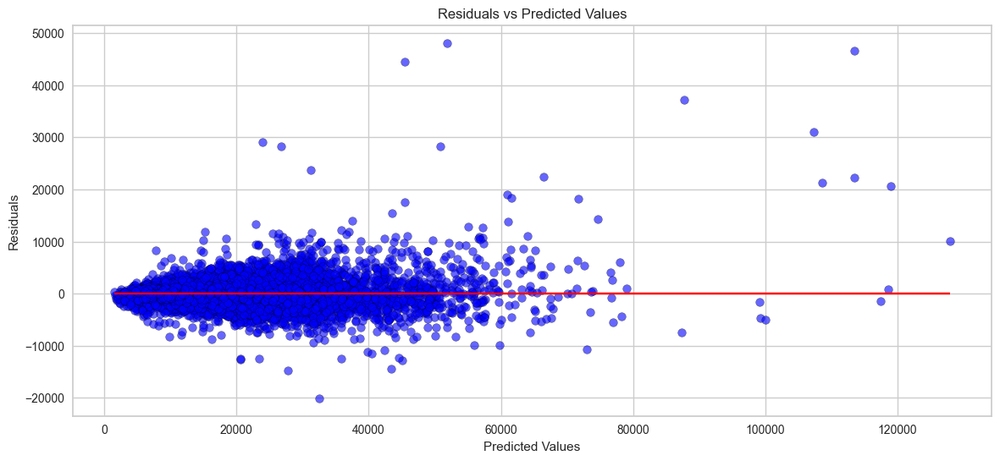

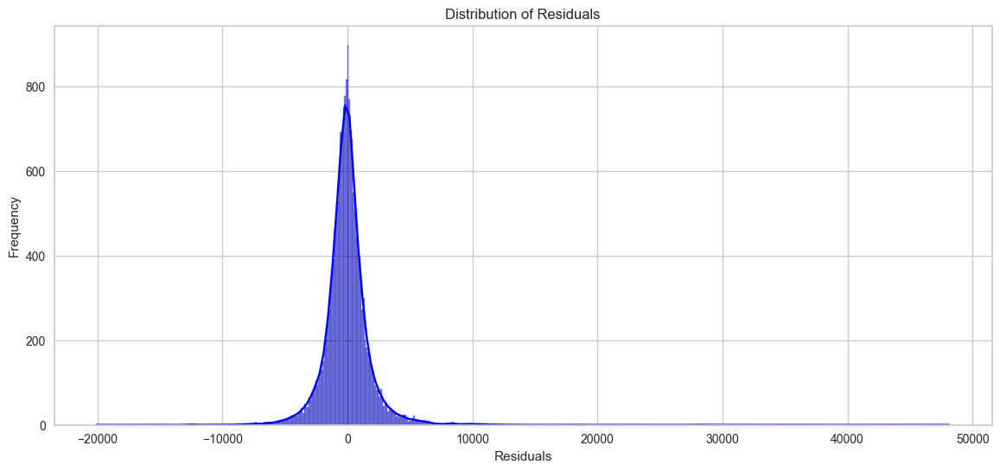

In [30]:
# Calculate residuals
residuals = y_test - y_test_pred

# Plot residuals
plt.figure(figsize=(14, 6))
plt.scatter(y_test_pred, residuals, color='blue', edgecolor='black', alpha=0.6)
plt.hlines(y=0, xmin=min(y_test_pred), xmax=max(y_test_pred), colors='red')
plt.title('Residuals vs Predicted Values')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.show()

# Plot distribution of residuals
plt.figure(figsize=(14, 6))
sns.histplot(residuals, kde=True, color='blue')
plt.title('Distribution of Residuals')
plt.xlabel('Residuals')
plt.ylabel('Frequency')
plt.show()

Looks like many of the residuals are centered around 0, indicating good model performance. However, there are some noticeable outliers, suggesting some struggle with certain predictions. 

In [34]:
# Calculate residuals and determine outliers for training and test sets
y_test_pred = best_rf.predict(X_test)
test_residuals = y_test - y_test_pred

y_train_full_pred = best_rf.predict(X_train_full)
train_full_residuals = y_train_full - y_train_full_pred

In [35]:
# Calculate IQR for residuals in training set
Q1_train = np.percentile(train_full_residuals, 25)
Q3_train = np.percentile(train_full_residuals, 75)
IQR_train = Q3_train - Q1_train
lower_bound_train = Q1_train - 1.5 * IQR_train
upper_bound_train = Q3_train + 1.5 * IQR_train
train_non_outliers_mask = (train_full_residuals >= lower_bound_train) & (train_full_residuals <= upper_bound_train)

In [36]:
# Calculate IQR for residuals in test set
Q1_test = np.percentile(test_residuals, 25)
Q3_test = np.percentile(test_residuals, 75)
IQR_test = Q3_test - Q1_test
lower_bound_test = Q1_test - 1.5 * IQR_test
upper_bound_test = Q3_test + 1.5 * IQR_test
test_non_outliers_mask = (test_residuals >= lower_bound_test) & (test_residuals <= upper_bound_test)

In [37]:
# Filter the datasets to keep only non-outliers
X_train_full_cleaned = X_train_full[train_non_outliers_mask]
y_train_full_cleaned = y_train_full[train_non_outliers_mask]
X_test_cleaned = X_test[test_non_outliers_mask]
y_test_cleaned = y_test[test_non_outliers_mask]

In [38]:
# Retrain the Random Forest model on the cleaned training dataset
best_rf.fit(X_train_full_cleaned, y_train_full_cleaned)

# Evaluate the model on the cleaned test set
y_test_cleaned_pred = best_rf.predict(X_test_cleaned)

# Calculate the MAPE on the cleaned test set
cleaned_test_mape = mean_absolute_percentage_error(y_test_cleaned, y_test_cleaned_pred)
print(f'Test Mean Absolute Percentage Error (MAPE) after removing outliers: {cleaned_test_mape:.2%}')

Test Mean Absolute Percentage Error (MAPE) after removing outliers: 6.42%


A noticeable improvement, considering the original test MAPE (7.49%).  